In [1]:
import os

import wget
from download import download
from wget import download, bar_thermometer
import shutil

In [2]:
def create_folder_if_not_exists(path):
    if not os.path.isdir(path):
        os.mkdir(path)
        return True # папка была создана
    return False # папка не была создана

In [3]:
ORIG_DATASET = os.path.abspath('./datasets/orig/data.yaml')
RESIZED_DATASET = os.path.abspath('./datasets/resized/data.yaml')

In [4]:
create_folder_if_not_exists('./models')
if not os.path.exists('./models/YOLOv8m-seg.pt'):
    download('https://github.com/ultralytics/assets/releases/download/v0.0.0/yolov8m-seg.pt', './models/', bar=wget.bar_thermometer)

In [5]:
from ultralytics import YOLO
import torch

In [6]:
# if os.path.exists('./models/RDD.pt'):
#     model = YOLO('./models/RDD.pt')
# else:
model = YOLO('./models/YOLOv8m-seg.pt')

In [7]:
results = model.train(data=ORIG_DATASET, epochs=1000, patience=500, batch=4, workers=4, lr0=0.01, lrf=0.01, cls=1.0, weight_decay=0.0001, iou=0.2, imgsz=768, visualize=True, pretrained=True, max_det=800)


New https://pypi.org/project/ultralytics/8.0.90 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.89  Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (NVIDIA GeForce GTX 1080, 8192MiB)
yolo\engine\trainer: task=segment, mode=train, model=./models/YOLOv8m-seg.pt, data=D:\University\RDD_YOLO\datasets\orig\data.yaml, epochs=100, patience=50, batch=4, imgsz=768, save=True, save_period=-1, cache=False, device=None, workers=4, project=None, name=None, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.15, max_det=800, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_thickness=3, visualize=True, augment=False, agnostic_nms=Fals

In [8]:
torch.cuda.empty_cache()

In [20]:
# shutil.copy('./runs/segment/train2/weights/best.pt', './models/RDD.pt')

'./models/RDD.pt'

In [9]:
import random
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import cv2

In [12]:
predict_model = YOLO('./runs/segment/train9/weights/last.pt')
# predict_model.val(data=ORIG_DATASET, batch=4, iou=0.2, plots=True)


image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\941602_RS_290_290RS070691_00915_RAW_jpg.rf.bdcf7412d39d26d22d984d2638861dc3.jpg: 480x768 5 potholes, 33.0ms
Speed: 4.0ms preprocess, 33.0ms inference, 3.0ms postprocess per image at shape (1, 3, 768, 768)

image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\1025771_RS_386_386RS169832_08595_RAW_jpg.rf.7ebb9b63a0449f0e9b4a5c23e8e9357b.jpg: 480x768 33 cracks, 34.0ms
Speed: 3.0ms preprocess, 34.0ms inference, 4.0ms postprocess per image at shape (1, 3, 768, 768)

image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\919806_RS_290_290RS294095_32481_RAW_jpg.rf.f708b614ae4681a29ff77d3904dd5e20.jpg: 480x768 29 cracks, 34.0ms
Speed: 4.0ms preprocess, 34.0ms inference, 3.0ms postprocess per image at shape (1, 3, 768, 768)

image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\1091726_DF_251_251BDF0490_00803_RAW_jpg.rf.d94b531328bc70f181a9e6f08c1c341c.jpg: 480x768 2 cracks, 28.0ms
Speed: 3.0ms preprocess, 28.0ms inferenc

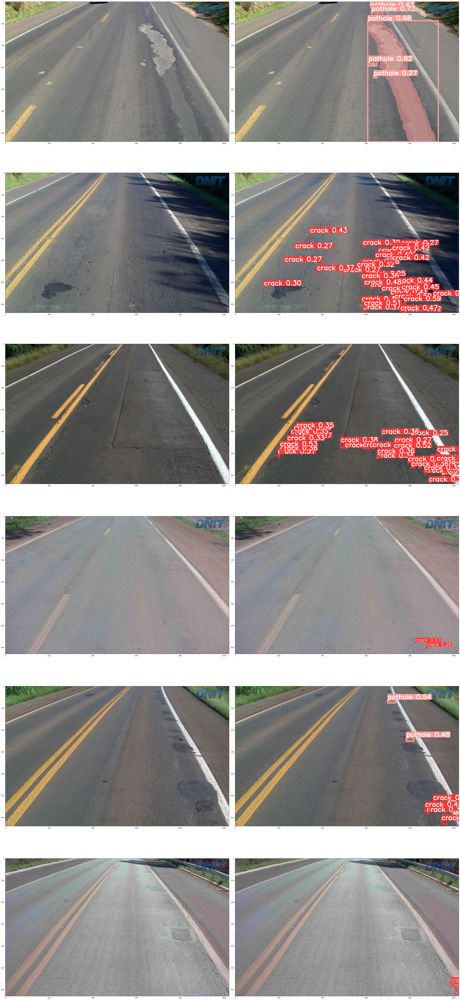

In [13]:
%matplotlib inline

test_imgs = os.listdir('./datasets/orig/test/images/')
random.shuffle(test_imgs)
imgs = test_imgs[:6]
_,axs = plt.subplots(len(imgs),2,figsize=(40,15 * len(imgs)))
for img, ax in zip(imgs, axs):
    img_pth = os.path.join(os.path.relpath('./datasets/orig/test/images/'), img)
    I = Image.open(img_pth)
    res = predict_model.predict(img_pth, iou=0.15)
    res0 = res[0]
    plotted = res0.plot(labels=True, boxes=True, masks=True, probs=True)
    img_pltd = cv2.cvtColor(plotted, cv2.COLOR_BGR2RGB)
    ax[0].imshow(I)
    ax[1].imshow(img_pltd)
    plt.sca(ax[1])
plt.tight_layout()
plt.show()